In [1]:
!pip install lightning comet_ml torchmetrics --quiet

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
jupyterlab-lsp 4.2.0 requires jupyter-lsp>=2.0.0, but you have jupyter-lsp 1.5.1 which is incompatible.


In [2]:
import os
import sys
import time
from copy import copy
import random

from tqdm import tqdm
import pickle

from PIL import Image
from matplotlib import pyplot as plt

import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
import torchvision
from torchvision import transforms
from torchvision import models
from torchvision.transforms import functional as transforms_F
from torchvision.ops import Conv2dNormActivation
from torchmetrics import Accuracy, Recall, F1Score
from lightning import pytorch as pl
from lightning.pytorch.loggers.comet import CometLogger

import pandas as pd
from sklearn.model_selection import train_test_split

/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6StatusC1EN10tensorflow5error4CodeESt17basic_string_viewIcSt11char_traitsIcEENS_14SourceLocationE']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so: undefined symbol: _ZTVN10tenso

## Data Trainsformation

In [3]:
INPUT_IMAGE_SIZE = 224
MAX_ORIGINAL_IMAGE_SIDE_TO_SIDE_RATIO = 4/3

In [4]:
def ensure_channels_first(x):
    if x.shape[-1] in {1, 2, 3, 6}:
        return x.swapaxes(-1, -2).swapaxes(-2, -3)

def ensure_channels_last(x):
    if x.shape[-1] not in {1, 2, 3, 6}:
        return x.swapaxes(-3, -2).swapaxes(-2, -1)

In [5]:
# Padding eliminator
def eliminate_pads(image, min_pad_size=10, interpolate_to_original=True):
    assert len(image.shape) == 3
    channels, h, w = image.shape

    image = 1. * image

    def is_uniform(x):
        return torch.pow(x - x.mean(), 2).sum()/x.numel() < 1e-3
    def is_diff_negligible(a, b):
        return torch.pow(a-b, 2).sum()/a.numel() < 1e-3

    # top paddings
    p_top = 1
    if is_uniform(image[:, 0, :]):
        while p_top < h and is_diff_negligible(image[:, 0, :], image[:, p_top, :]):
            p_top += 1
    p_top = p_top if p_top >= min_pad_size else 0

    # bottom paddings
    p_bottom = 1
    if is_uniform(image[:, -1, :]):
        while p_bottom < h and is_diff_negligible(image[:, -1, :], image[:, -1-p_bottom, :]):
            p_bottom += 1
    p_bottom = p_bottom if p_bottom >= min_pad_size else 0

    # left paddings
    p_left = 1
    if is_uniform(image[:, :, 0]):
        while p_left < w and is_diff_negligible(image[:, :, 0], image[:, :, p_left]):
            p_left += 1
    p_left = p_left if p_left >= min_pad_size else 0

    # right paddings
    p_right = 1
    if is_uniform(image[:, :, -1]):
        while p_right < w and is_diff_negligible(image[:, :, -1], image[:, :, -1-p_right]):
            p_right += 1
    p_right = p_right if p_right >= min_pad_size else 0

    # if there is something to crop ...
    if p_top + p_bottom + p_left + p_right != 0:

        # size of the crop
        new_h = max(h - p_top - p_bottom, 2)
        new_w = max(w - p_left - p_right, 2)

        # crop
        y, x = max(0, min(p_top, h - 2)), max(0, min(p_left, w - 2))
        image = transforms_F.crop(image, y, x, new_h, new_w)

        # return to original size if needed
        if interpolate_to_original:
            image = transforms.Resize((h, w), antialias=True)(image)

    return image


In [6]:
def train_pair_transform(im1, im2):

    # Image preprocessor for LunRGB224 dataset
    
    assert im1.shape == im2.shape, f"{im1.shape}, {im2.shape}"
    assert im1.shape[0] == 3, im1.shape[1] == im1.shape[2] == 224
    
    # eliminate borders upon radom
    if random.uniform(0., 1.) > 2/3:
        im1 = eliminate_pads(im1, min_pad_size=6, interpolate_to_original=True)
    if random.uniform(0., 1.) > 2/3:
        im2 = eliminate_pads(im2, min_pad_size=6, interpolate_to_original=True)
    
    # jitter
    transform = transforms.ColorJitter(.3, .2)
    im1 = transform(im1)
    im2 = transform(im2)
    
    # random erase
    transform = transforms.RandomErasing(.5, scale=(0.02, 0.07), value=random.uniform(0., 1.))
    im1 = transform(im1)
    im2 = transform(im2)
    
    aggregated = torch.cat([im1, im2])
    
    return aggregated

In [7]:
def val_pair_transform(im1, im2):

    # Image preprocessor for LunRGB224 dataset
    
    assert im1.shape == im2.shape,f"{im1.shape}, {im2.shape}"
    assert im1.shape[0] == 3, im1.shape[1] == im1.shape[2] == 224
    
    # eliminate pads
    im1 = eliminate_pads(im1, min_pad_size=6, interpolate_to_original=True)
    im2 = eliminate_pads(im2, min_pad_size=6, interpolate_to_original=True)
    
    aggregated = torch.cat([im1, im2])
    
    return aggregated

In [8]:
def test_pair_transform(im1, im2):
    
    def crop_if_needed(tensor):
        w = tensor.shape[-1]
        h = tensor.shape[-2]
        if max(h/w, w/h) > MAX_ORIGINAL_IMAGE_SIDE_TO_SIDE_RATIO:
            if h > w:
                h = int(w * MAX_ORIGINAL_IMAGE_SIDE_TO_SIDE_RATIO)
            else:
                w = int(h * MAX_ORIGINAL_IMAGE_SIDE_TO_SIDE_RATIO)

            tensor = transforms.CenterCrop((h, w))(tensor)
        return tensor
    
    # crop if needed
    im1 = crop_if_needed(im1)
    im2 = crop_if_needed(im2)
    
    # eliminate pads
    im1 = eliminate_pads(im1, min_pad_size=6, interpolate_to_original=False)
    im2 = eliminate_pads(im2, min_pad_size=6, interpolate_to_original=False)

    # resize
    transform = transforms.Resize((INPUT_IMAGE_SIZE, INPUT_IMAGE_SIZE), interpolation=transforms.InterpolationMode.BILINEAR, antialias=True)
    im1 = transform(im1)
    im2 = transform(im2)
    
    # aggregate
    aggregated = torch.cat([im1, im2])

    return aggregated

## Dataset

In [9]:
class NDLabeledDataset(Dataset):
    def __init__(
        self,
        train_csv_path,
        train_dir_path,
        pair_transform, # gets two tensors, returns X 
    ):
        if not os.path.exists(train_dir_path):
            raise Exception('This image directory does not exist')
            
        self.metadata = [(row['image_url1'].split('/')[-1], 
                          row['image_url2'].split('/')[-1], 
                          row['is_same']) for idx, row in pd.read_csv(train_csv_path).iterrows()]
        self.dir_path = train_dir_path
        self.pair_transform = pair_transform
        
    
    def __len__(self):
        return len(self.metadata)
    
    def __getitem__(self, i):
        triplet = self.metadata[i]
        im1_path = os.path.join(self.dir_path, str(triplet[0]))
        im2_path = os.path.join(self.dir_path, str(triplet[1]))
        label = triplet[2]
        
        try:
            im1 = transforms.ToTensor()(Image.open(im1_path))
            im2 = transforms.ToTensor()(Image.open(im2_path))
            assert im1.shape[0] == im2.shape[0] == 3
        except:
            u = random.uniform(0,1)
            im1 = torch.zeros(3, INPUT_IMAGE_SIZE, INPUT_IMAGE_SIZE) + u
            im2 = torch.zeros(3, INPUT_IMAGE_SIZE, INPUT_IMAGE_SIZE) + u
            label = 1
        
        return self.pair_transform(im1, im2), 1.*torch.tensor(label)
    
    def set_transform(self, pair_transform):
        self.pair_transform = pair_transform
        
        
    def get_train_val_split(self, val_size, seed=None):
        # In other words, we split set of edges so that
        # if an edge is in graph G
        # all the edges of this graph are in this set.
        # This will ensure that images used in train 
        # and validation datasets are different.
        # We propose greedy algorithm that works
        # fine for datasets with many graphs (e.g. >1000)
        
        desired_val_size = int(len(self.metadata) * val_size)
        
        progress_bar = tqdm(total=desired_val_size, unit='step')
        
        pool = set(self.metadata)
        
        val_metadata = []
        
        while len(val_metadata) < desired_val_size:
            graph = {random.choice(list(pool))}
            edges_to_check = list(graph)
            pool.remove(edges_to_check[0])
            
            while len(edges_to_check) > 0:
                edge_to_check = edges_to_check.pop(0)
                # BFS
                pool_copy = copy(pool)
                for current_edge in pool_copy:
                    if {current_edge[0], current_edge[1]} & {edge_to_check[0], edge_to_check[1]}:
                        # if those edges share a vertex remove the edge from the pool
                        # and add to current graph and edges_to_check
                        edges_to_check.append(current_edge)
                        graph.add(current_edge)
                        pool.remove(current_edge)
            
            for edge in graph:
                val_metadata.append(edge)
            progress_bar.update(len(graph))
        
        train_metadata = list(pool)
        
        train_ds = copy(self)
        val_ds = copy(self)
        train_ds.metadata = train_metadata
        val_ds.metadata = val_metadata
        
        return train_ds, val_ds

In [10]:
class NDTestDataset(Dataset):
    def __init__(
        self,
        test_csv_path,
        test_dir_path,
        pair_transform, # gets two tensors, returns X 
    ):
        
        if not os.path.exists(test_dir_path):
            raise Exception('This image directory does not exist')
        self.metadata_df = pd.read_csv(test_csv_path)
        self.dir_path = test_dir_path
        self.pair_transform = pair_transform
        
    
    def __len__(self):
        return len(self.metadata_df)
    
    def __getitem__(self, i):
        row = self.metadata_df.iloc[i]
        idx = row[0]
        im1_name = str(row[1]).split('/')[-1]
        im2_name = str(row[2]).split('/')[-1]
        im1_path = os.path.join(self.dir_path, im1_name)
        im2_path = os.path.join(self.dir_path, im2_name)
        
        try:
            im1 = transforms.ToTensor()(Image.open(im1_path))
        except:
            im1 = torch.zeros(3, INPUT_IMAGE_SIZE, INPUT_IMAGE_SIZE)
            print(f'Item {i}-1, idx {idx}, {im1_path} cannot be loaded')
        if im1.shape[0] != 3:
            print(f'Item {i}-1, idx {idx}, {im1_path} does not have 3 channels, neglecting the rest')
            im1 = im1[:3, :, :]
        
        try:
            im2 = transforms.ToTensor()(Image.open(im2_path))
        except:
            im2 = torch.zeros(3, INPUT_IMAGE_SIZE, INPUT_IMAGE_SIZE)
            print(f'Item {i}-2, idx {idx}, {im2_path} cannot be loaded')
        if im2.shape[0] != 3:
            print(f'Item {i}-2, idx {idx}, {im2_path} does not have 3 channels, neglecting the rest')
            im2 = im2[:3, :, :]
        
        return idx, self.pair_transform(im1, im2)

In [11]:
dataset = NDLabeledDataset(
    '/kaggle/input/lunreducedgrayscale128metadata/train.csv/train.csv', 
    '/kaggle/input/lunrbg224/LunRGB224', 
    train_pair_transform
)
# train_dataset, val_dataset = dataset.get_train_val_split(0.1)
train_dataset, val_dataset = copy(dataset), copy(dataset)
with open('/kaggle/input/lunreducedgrayscale128metadata/train_metadata_010.pkl', 'rb') as f:
    train_dataset.metadata = pickle.load(f)
with open('/kaggle/input/lunreducedgrayscale128metadata/val_metadata_010.pkl', 'rb') as f:
    val_dataset.metadata = pickle.load(f)
    
val_dataset.set_transform(val_pair_transform)
        
print(f"Examples:\n\tTrain: {len(train_dataset)}\n\tValidation: {len(val_dataset)}\n\tTotal: {len(dataset)}")
del dataset

Examples:
	Train: 81575
	Validation: 9063
	Total: 90638


In [12]:
# check if any photo is in both train and validation datasets (unacceptable)
train_imgs = set(r[0] for r in train_dataset.metadata) or set(r[1] for r in train_dataset.metadata)
val_imgs = set(r[0] for r in val_dataset.metadata) or set(r[1] for r in val_dataset.metadata)
print(len(train_imgs), len(val_imgs), len(train_imgs & val_imgs))

74636 6953 0


## Render several images

In [13]:
def render_idx(dataset, idx):
    fig, axes = plt.subplots(len(idx), 2, figsize=(10, 4*len(idx)))
    fig.tight_layout()
    
    for i, n in enumerate(idx):
        x1, x2 = ensure_channels_last(dataset[n][0][:3]), ensure_channels_last(dataset[n][0][3:])
        axes[i,0].imshow(x1)
        axes[i,1].imshow(x2)
        
        axes[i,0].set_title('Label: ' + str(float(dataset[n][1])))
        

In [14]:
def render_random_pairs(dataset, n):
    idx = [random.randint(0, len(dataset)-1) for _ in range(n)]
    render_idx(dataset, idx)

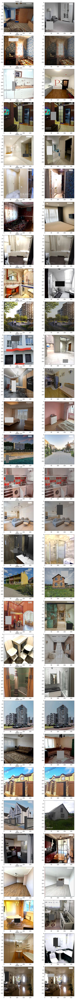

In [15]:
render_random_pairs(train_dataset, 30)

## Model

In [16]:
class Normalizer(nn.Module):
    def __init__(self):
        super().__init__()
        
        self.normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    
    def forward(self, x):
        x = self.normalize(x)
        return x
    
    
class Encoder(nn.Module):
    def __init__(
        self,
    ):
        super().__init__()

        self.efficientnet = models.efficientnet_b0(weights='IMAGENET1K_V1')
    
    def forward(self, x):
        x = self.efficientnet(x)
        return x

class PostEncoder(nn.Module):
    def __init__(self, in_dim, out_dim):
        super().__init__()
        
        self.relu = nn.ReLU(inplace=True)
        self.dense1 = nn.Linear(in_dim, out_dim)
    
    def forward(self, x):
        x = self.relu(x)
        x = self.dense1(x)
        return x
    

class Comparator(nn.Module):
    def __init__(
        self,
        expected_in_dim
    ):
        super().__init__()
        self.layer = nn.Linear(1, 1)
        self.expected_in_dim = expected_in_dim

        state_dict = self.state_dict()
        state_dict['layer.weight'] = torch.tensor([[-.5]])
        state_dict['layer.bias'] = torch.tensor([2])
        self.load_state_dict(state_dict)

    def forward(self, a, b):
        assert a.shape[-1] == self.expected_in_dim

        dist = torch.pow(a - b, 2).sum(dim=-1, keepdim=True) / self.expected_in_dim
        logit = self.layer(dist).squeeze(-1)
        return logit



class Model(nn.Module):
    def __init__(
        self,
    ):
        super().__init__()

        latent_dim = 128
        
        self.normalizer = Normalizer()
        self.encoder = Encoder()
        self.post_encoder = PostEncoder(1000, latent_dim)

        self.comparator = Comparator(latent_dim)

    def forward(self, x1, x2):
        x1 = self.normalizer(x1)
        x2 = self.normalizer(x2)
        
        x1 = self.encoder(x1)
        x2 = self.encoder(x2)
        
        x1 = self.post_encoder(x1)
        x2 = self.post_encoder(x2)
        
        logit = self.comparator(x1, x2)
        return logit


In [17]:
model = Model()

Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-3dd342df.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-3dd342df.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 83.9MB/s]


In [18]:
model.comparator.state_dict()

OrderedDict([('layer.weight', tensor([[-0.5000]])),
             ('layer.bias', tensor([2.]))])

In [19]:
a = torch.rand(2, 3, INPUT_IMAGE_SIZE, INPUT_IMAGE_SIZE)
b = torch.rand(2, 3, INPUT_IMAGE_SIZE, INPUT_IMAGE_SIZE)
model(a,b).shape

torch.Size([2])

## Metrics helper

In [20]:
def precision_given_f1_recall(f1, recall, eps=1e-7):
    return (recall * f1 + eps) / (2*recall - f1 + eps)

## Training

In [21]:
class PLModel(pl.LightningModule):
    def __init__(
        self, 
        model,
        criterion,
        lr,
        wd=0,
    ):
        super().__init__()
        
        self.model = model
        self.criterion = criterion
        self.lr = lr
        self.wd = wd
        
        self.val_accuracy = Accuracy('binary')
        self.val_recall = Recall('binary')
        self.val_f1 = F1Score('binary')
        self.train_accuracy = Accuracy('binary')
        self.train_recall = Recall('binary')
        self.train_f1 = F1Score('binary')
        
        self.save_hyperparameters()

        
    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=self.lr, weight_decay=self.wd)
    
    def forward(self, x1, x2):
        return self.model(x1, x2)
    
    def training_step(self, batch, batch_idx):
        aggregated, y = batch
        x1 = aggregated[:, :3, :, :]
        x2 = aggregated[:, 3:, :, :]
        
        logit = self(x1, x2)
        
        loss = self.criterion(logit, y)
        self.log('train_loss', loss, sync_dist=True)
        preds = 1.*(logit > 0)
        self.train_accuracy(preds, y)
        self.train_recall(preds, y)
        self.train_f1(preds, y)
        return loss

    def validation_step(self, batch, batch_idx):
        aggregated, y = batch
        x1 = aggregated[:, :3, :, :]
        x2 = aggregated[:, 3:, :, :]
        
        logit = self(x1, x2)
        
        loss = self.criterion(logit, y)
        self.log('val_loss', loss, prog_bar=True, sync_dist=True)
        
        preds = 1.*(logit > 0)
        self.val_accuracy(preds, y)
        self.val_recall(preds, y)
        self.val_f1(preds, y)
        return loss
    
    def on_train_epoch_end(self):
        acc = self.train_accuracy.compute()
        recall = self.train_recall.compute()
        f1 = self.train_f1.compute()
        self.log('train_acc', acc, sync_dist=True)
        self.log('train_precision', precision_given_f1_recall(f1, recall), sync_dist=True)
        self.log('train_recall', recall, sync_dist=True)
        self.log('train_f1', f1, sync_dist=True)
        
        self.log('comparator/w', model.comparator.state_dict()['layer.weight'].item(), sync_dist=True)
        self.log('comparator/b', model.comparator.state_dict()['layer.bias'].item(), sync_dist=True)

    def on_validation_epoch_end(self):
        acc = self.val_accuracy.compute()
        recall = self.val_recall.compute()
        f1 = self.val_f1.compute()
        self.log('val_acc', acc, sync_dist=True)
        self.log('val_precision', precision_given_f1_recall(f1, recall), sync_dist=True)
        self.log('val_recall', recall, sync_dist=True)
        self.log('val_f1', f1, sync_dist=True)

In [22]:
pl_model = PLModel(
    model,
    nn.BCEWithLogitsLoss(),
    1e-4,
    wd=1e-5,
)

/opt/conda/lib/python3.10/site-packages/lightning/pytorch/utilities/parsing.py:196: UserWarning: Attribute 'model' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['model'])`.
  rank_zero_warn(
/opt/conda/lib/python3.10/site-packages/lightning/pytorch/utilities/parsing.py:196: UserWarning: Attribute 'criterion' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['criterion'])`.
  rank_zero_warn(


In [23]:
checkpoint_callback = pl.callbacks.ModelCheckpoint(
    monitor='val_f1',  # Metric to monitor for saving the best model
    mode='max',          # Whether to minimize or maximize the monitored metric
    filename='best_model',  # Name of the saved checkpoint file
    save_top_k=3         # Save only the best model (set to 3 to save top 3, for example)
)

In [24]:
logger = CometLogger(
    api_key='VHZ1D3GixsI0P9LRnDFEHYrAG',
    project_name='hackathon_lun_reduced',
    experiment_name='224-rgb-efficientnet'
)

INFO: CometLogger will be initialized in online mode


In [25]:
logger.log_hyperparams({
    'train_dataset': "LunRGB224",
    'input_image_size': INPUT_IMAGE_SIZE,
    'description': "EfficientNetB0, val_set 10%, Full dataset"
})

COMET WARNING: To get all data logged automatically, import comet_ml before the following modules: torch, keras, tensorboard, tensorflow.
COMET WARNING: As you are running in a Jupyter environment, you will need to call `experiment.end()` when finished to ensure all metrics and code are logged before exiting.
COMET INFO: Couldn't find a Git repository in '/kaggle/working' nor in any parent directory. Set `COMET_GIT_DIRECTORY` if your Git Repository is elsewhere.
COMET INFO: Experiment is live on comet.com https://www.comet.com/hotsteel1312/hackathon-lun-reduced/05a5d59dada043a68b79688c041d9798



In [26]:
trainer = pl.Trainer(max_epochs=40, val_check_interval=1/2, callbacks=[checkpoint_callback], logger=logger)

INFO: GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs


In [27]:
train_dataloader = DataLoader(train_dataset, 32, shuffle=True, num_workers=8)
val_dataloader = DataLoader(val_dataset, 32, shuffle=False, num_workers=8)

/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [28]:
trainer.fit(
    pl_model, 
    train_dataloaders=train_dataloader,
    val_dataloaders=val_dataloader,
)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name           | Type              | Params
-----------------------------------------------------
0 | model          | Model             | 5.4 M 
1 | criterion      | BCEWithLogitsLoss | 0     
2 | val_accuracy   | BinaryAccuracy    | 0     
3 | val_recall     | BinaryRecall      | 0     
4 | val_f1         | BinaryF1Score     | 0     
5 | train_accuracy | BinaryAccuracy    | 0     
6 | train_recall   | BinaryRecall      | 0     
7 | train_f1       | BinaryF1Score     | 0     
-----------------------------------------------------
5.4 M     Trainable params
0         Non-trainable params
5.4 M     Total params
21.667    Total estimated model params size (MB)
COMET WARNING: truncated string; too long: 'Model(
  (normalizer): Normalizer(
    (normalize): Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
  )
  (encoder): Encoder(
    (efficientnet): EfficientNet(
      (features): Sequential(
        (0): Conv2dNormA

Sanity Checking: 0it [00:00, ?it/s]

/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Training: 0it [00:00, ?it/s]

/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

/opt/conda/lib/python3.10/site-packages/lightning/pytorch/trainer/call.py:52: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")
COMET INFO: ---------------------------------------------------------------------------------------
COMET INFO: Comet.ml Experiment Summary
COMET INFO: ---------------------------------------------------------------------------------------
COMET INFO:   Data:
COMET INFO:     display_summary_level : 1
COMET INFO:     url                   : https://www.comet.com/hotsteel1312/hackathon-lun-reduced/05a5d59dada043a68b79688c041d9798
COMET INFO:   Metrics [count] (min, max):
COMET INFO:     comparator/b [10]    : (2.117114305496216, 4.058838367462158)
COMET INFO:     comparator/w [10]    : (-0.5556897521018982, -0.5104356408119202)
COMET INFO:     train_acc [10]       : (0.9461109638214111, 0.9934306144714355)
COMET INFO:     train_f1 [10]        : (0.9210545420646

In [30]:
model.eval()
trainer.validate(pl_model, dataloaders=val_dataloader, verbose=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
COMET WARNING: truncated string; too long: 'Model(
  (normalizer): Normalizer(
    (normalize): Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
  )
  (encoder): Encoder(
    (efficientnet): EfficientNet(
      (features): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): SiLU(inplace=True)
        )
        (1): Sequential(
          (0): MBConv(
            (block): Sequential(
              (0): Conv2dNormActivation(
                (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
                (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
                (2): SiLU(inplace=True)
              )
              (1): SqueezeExcitation(
        

Validation: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_acc          │    0.9968653917312622     │
│          val_f1           │    0.9919999837875366     │
│         val_loss          │   0.011854431591928005    │
│       val_precision       │    0.9848262071609497     │
│        val_recall         │    0.9992790818214417     │
└───────────────────────────┴───────────────────────────┘

COMET INFO: ---------------------------------------------------------------------------------------
COMET INFO: Comet.ml ExistingExperiment Summary
COMET INFO: ---------------------------------------------------------------------------------------
COMET INFO:   Data:
COMET INFO:     display_summary_level : 1
COMET INFO:     url                   : https://www.comet.com/hotsteel1312/hackathon-lun-reduced/05a5d59dada043a68b79688c041d9798
COMET INFO:   Metrics:
COMET INFO:     val_acc       : 0.9968653917312622
COMET INFO:     val_f1        : 0.9919999837875366
COMET INFO:     val_loss      : 0.011854431591928005
COMET INFO:     val_precision : 0.9848262071609497
COMET INFO:     val_recall    : 0.9992790818214417
COMET INFO:   Others:
COMET INFO:     Created from                 : pytorch-lightning
COMET INFO:     Name                         : 224-rgb-efficientnet
COMET INFO:     sys.already_imported_modules : ["torch", "keras", "tensorboard", "tensorflow"]
COMET INFO:   Parameters:
COME

[{'val_loss': 0.011854431591928005,
  'val_acc': 0.9968653917312622,
  'val_precision': 0.9848262071609497,
  'val_recall': 0.9992790818214417,
  'val_f1': 0.9919999837875366}]

In [31]:
torch.save(model, 'model_older.pt')

In [32]:
logger.experiment.log_model("model_older", "model_older.pt")

COMET WARNING: To get all data logged automatically, import comet_ml before the following modules: torch, keras, tensorboard, tensorflow.
COMET WARNING: As you are running in a Jupyter environment, you will need to call `experiment.end()` when finished to ensure all metrics and code are logged before exiting.
COMET INFO: Couldn't find a Git repository in '/kaggle/working' nor in any parent directory. Set `COMET_GIT_DIRECTORY` if your Git Repository is elsewhere.
COMET INFO: Experiment is live on comet.com https://www.comet.com/hotsteel1312/hackathon-lun-reduced/05a5d59dada043a68b79688c041d9798



{'web': 'https://www.comet.com/api/asset/download?assetId=febeba766e0349f08b5c5850a1c5a8d6&experimentKey=05a5d59dada043a68b79688c041d9798',
 'api': 'https://www.comet.com/api/rest/v2/experiment/asset/get-asset?assetId=febeba766e0349f08b5c5850a1c5a8d6&experimentKey=05a5d59dada043a68b79688c041d9798',
 'assetId': 'febeba766e0349f08b5c5850a1c5a8d6'}

## Render wrongly classified validation entries

In [33]:
class Classify:
    def __init__(self, model):
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'
        self.model = model.to(self.device)
    
    def __call__(self, x1, x2):
        return self.get_prob(x1, x2) > .5
    
    def get_prob(self, x1, x2):
        assert x1.shape == x2.shape
        while len(x1.shape) < 4:
            x1 = x1.unsqueeze(0)
            x2 = x2.unsqueeze(0)
        
        x1 = x1.to(self.device)
        x2 = x2.to(self.device)
            
        self.model.eval()
        with torch.no_grad():
            return torch.sigmoid(self.model(x1, x2)).item()

In [34]:
def get_wrongly_classified_idx(dataset, classify):
    misclassified = []
    for i in tqdm(range(len(dataset))):
        aggregated, y = dataset[i]
        x1 = aggregated[:3, :, :]
        x2 = aggregated[3:, :, :]
        
        y_hat = classify(x1, x2)
        
        if y_hat != y:
            misclassified.append(i)
    
    return misclassified

In [35]:
def render_wrongly_classified(dataset, misclassified, classify):
    fig, axes = plt.subplots(len(misclassified), 2, figsize=(10, 4*len(misclassified)))
    fig.tight_layout()
    
    for i, n in enumerate(misclassified):
        
        x1, x2 = dataset[n][0][:3], dataset[n][0][3:]
        axes[i,0].imshow(ensure_channels_last(x1))
        axes[i,1].imshow(ensure_channels_last(x2))
        
        axes[i,0].set_title('Idx: ' + str(n) + ' Label: ' + str(float(dataset[n][1])))
        axes[i,1].set_title('Pred: ' + str(float(classify.get_prob(x1, x2))))
        

In [36]:
classify = Classify(model)

In [37]:
misclassified = get_wrongly_classified_idx(val_dataset, classify)


100%|██████████| 9063/9063 [03:48<00:00, 39.58it/s]


In [38]:
len(misclassified)

31

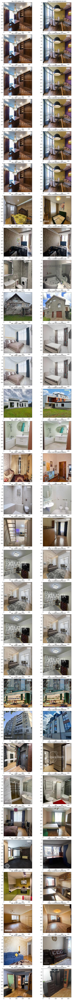

In [39]:
render_wrongly_classified(val_dataset, misclassified[:50], classify)

## Predict

In [ ]:
test_dataset = NDTestDataset(
    '/kaggle/input/luntestoriginal/test-data 3.csv',
    '/kaggle/input/luntestoriginal/images',
    test_pair_transform
)

In [ ]:
def get_predictions(model, dataset, device=None):
    device = device if device else ('cuda' if torch.cuda.is_available() else 'cpu')
    model = model.to(device)
    predictions = {'ID': [], 'same': [], 'different': []}
    dataloader = DataLoader(dataset, 32, num_workers=8)
    
    for idx, x in tqdm(dataloader):
        if len(x.shape) == 3:
            x = x.unsqueeze(0)
        
        x = x.to(device)
        
        x1, x2 = x[:, :3, :, :], x[:, 3:, :, :]
        
        logit = model(x1, x2)
        preds = 1*(logit > .0)
        
        for i, pred in zip(idx, preds):
            predictions['ID'].append(int(i))
            predictions['same'].append(int(pred))
            predictions['different'].append(1 - int(pred))
    return predictions
    

In [ ]:
predictions = get_predictions(model, test_dataset)

In [ ]:
submission_df = pd.DataFrame(predictions)

In [ ]:
submission_df.head()

In [ ]:
len(submission_df)

In [ ]:
submission_df.to_csv('test-submission.csv', index=False)